# Multi-Disease Detection in Tomato Plant
# Part 2: Object Detection

## Import Libraries

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os 
import cv2
import seaborn as sns

# sklearn
from sklearn.model_selection import train_test_split


# Tensorflow
import tensorflow as tf
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, Dense, Flatten, MaxPooling2D, Dropout
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, TensorBoard  
from tensorflow.keras.utils import normalize
from tensorflow.keras.optimizers import Adam
from keras.utils import to_categorical
from tensorflow.keras.metrics import Precision
# metrics
from sklearn.metrics import classification_report, confusion_matrix

## Get Data

In [4]:
train_path = r'C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/Tomata Leaf Disease Dataset 0/tomato/train'

Categories = [Class for Class in os.listdir(train_path)]

train_data = []

for category in Categories:
    label = Categories.index(category)
    path = os.path.join(train_path, category)
    for img in os.listdir(path):
        image = os.path.join(path, img)
        try:
            the_img = cv2.imread(image)
            the_img = cv2.resize(the_img, (150, 150))
            train_data.append([the_img, label])
        except Exception as ex:
            pass

In [5]:
test_path = r"C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/Tomata Leaf Disease Dataset 0/tomato/val"

Categories = [Class for Class in os.listdir(test_path)]

test_data = []

for category in Categories:
    label = Categories.index(category)
    path = os.path.join(test_path, category)
    for img in os.listdir(path):
        image = os.path.join(path, img)
        try:
            the_img = cv2.imread(image)
            the_img = cv2.resize(the_img, (150, 150))
            test_data.append([the_img, label])
        except Exception as ex:
            pass

## Split the Dataset

In [6]:
# On The Train Data
X = []
y = []

for features, labels in train_data:
    X.append(features)
    y.append(labels)
    
X = np.array(X) # Features
y = np.array(y) # Targets

In [7]:
# Split To Train and Validation
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.13, random_state=42, shuffle=True)

In [8]:
# On The Test Data
X_test = []
y_test = []

for features, labels in test_data:
    X_test.append(features)
    y_test.append(labels)
    
X_test = np.array(X_test) # Features
y_test = np.array(y_test) # Targets

In [9]:
# shapes
print(f"X_train shape is {X_train.shape}")
print(f"y_train shape is {y_train.shape}")
print(f"X_valid shape is {X_valid.shape}")
print(f"y_valid shape is {y_valid.shape}")
print(f"X_test shape is {X_test.shape}")
print(f"y_test shape is {y_test.shape}")

X_train shape is (7830, 150, 150, 3)
y_train shape is (7830,)
X_valid shape is (1170, 150, 150, 3)
y_valid shape is (1170,)
X_test shape is (882, 150, 150, 3)
y_test shape is (882,)


## Exploratory Data Analysis - EDA

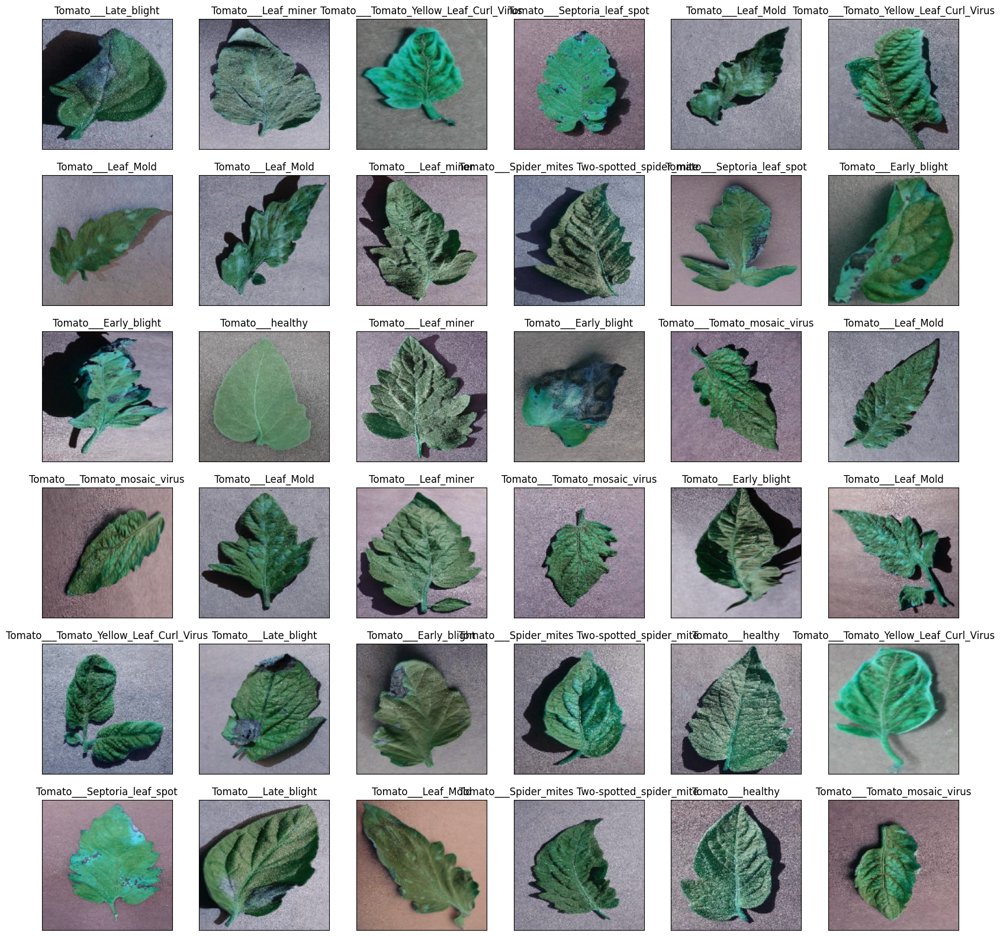

In [10]:
plt.figure(figsize=(20, 20))
for i in range(36):
    plt.subplot(6, 6, i+1)
    plt.imshow(X_train[i])
    plt.title(f"{Categories[y_train[i]]}")
    plt.xticks([])
    plt.yticks([])
    
plt.show()

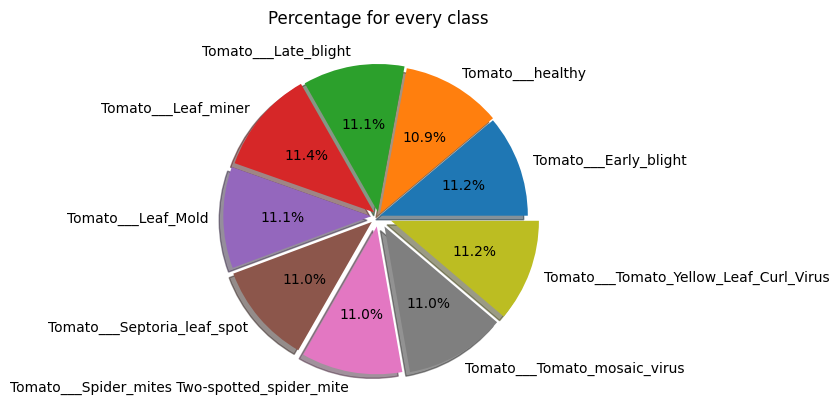

In [11]:
plt.pie([len(y_train[y_train == 0]), len(y_train[y_train == 1]), len(y_train[y_train == 2]), len(y_train[y_train == 3]),
          len(y_train[y_train == 4]), len(y_train[y_train == 5]), len(y_train[y_train == 6]), len(y_train[y_train == 7]),
          len(y_train[y_train == 8])],  
         labels=Categories, autopct="%1.1f%%", shadow=True, explode=[i for i in np.arange(0.01, 0.1, 0.01)])  

plt.title("Percentage for every class")
plt.show()

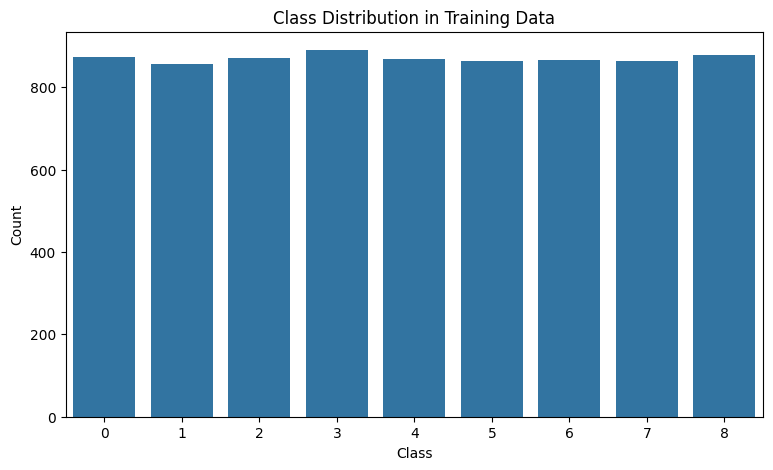

In [12]:
plt.figure(figsize=(9, 5))
sns.countplot(x=y_train)
plt.title('Class Distribution in Training Data')
plt.xlabel('Class')
plt.ylabel('Count')
plt.show()

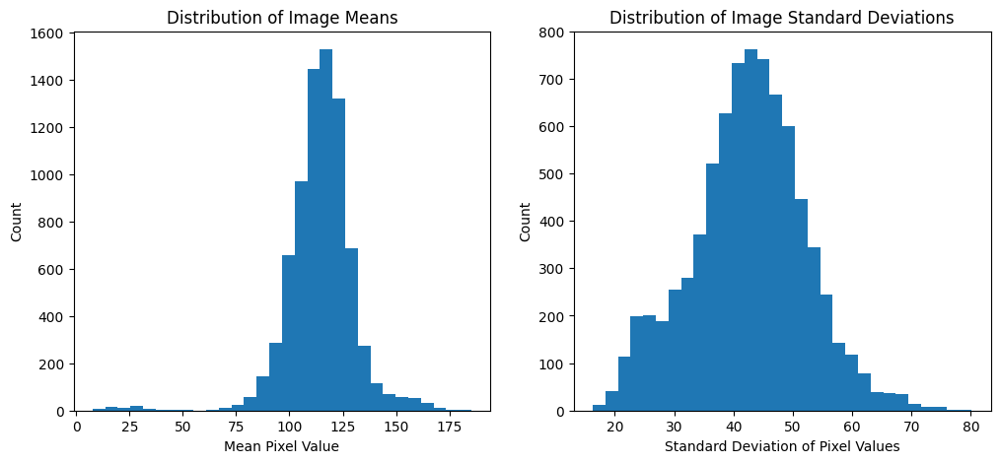

In [13]:
image_means = [np.mean(image) for image in X_train]
image_stds = [np.std(image) for image in X_train]

plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.hist(image_means, bins=30)
plt.title('Distribution of Image Means')
plt.xlabel('Mean Pixel Value')
plt.ylabel('Count')

plt.subplot(1, 2, 2)
plt.hist(image_stds, bins=30)
plt.title('Distribution of Image Standard Deviations')
plt.xlabel('Standard Deviation of Pixel Values')
plt.ylabel('Count')

plt.show()

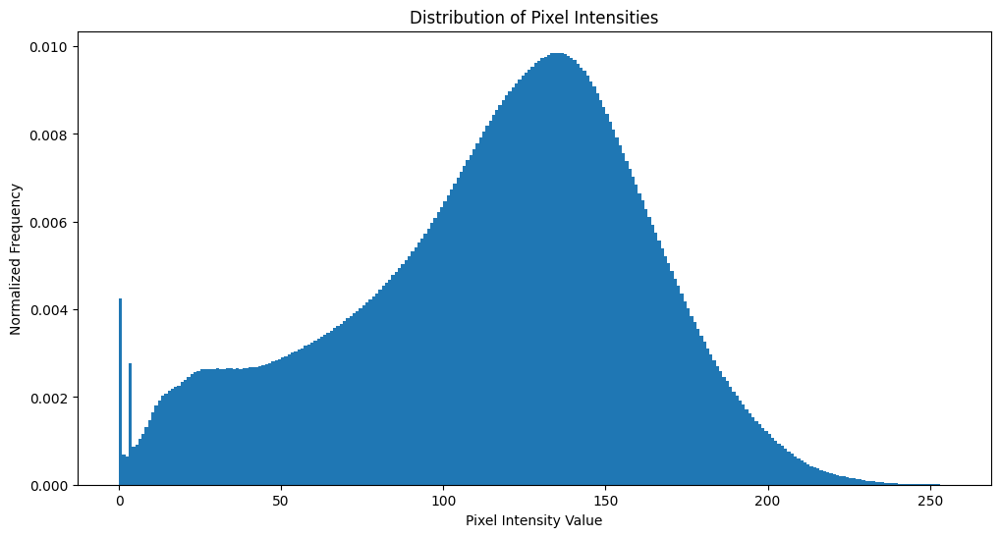

In [14]:
flattened_images = np.concatenate([image.flatten() for image in X_train])

# Plot the distribution of pixel intensities
plt.figure(figsize=(12, 6))
plt.hist(flattened_images, bins=256, range=[0, 256], density=True)
plt.title('Distribution of Pixel Intensities')
plt.xlabel('Pixel Intensity Value')
plt.ylabel('Normalized Frequency')
plt.show()

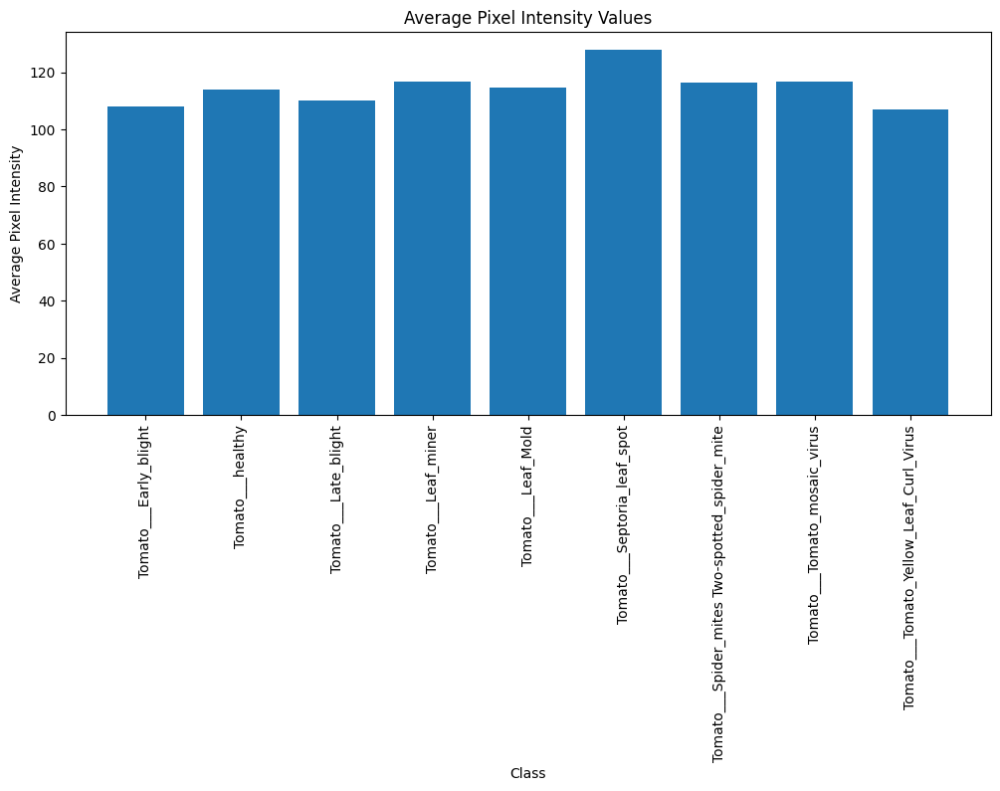

In [15]:
# ClassOne_average_intensity = np.mean([np.mean(image) for image, label in zip(X_train, y_train) if label == 0])
# ClassTow_average_intensity = np.mean([np.mean(image) for image, label in zip(X_train, y_train) if label == 1])
# Class3_average_intensity = np.mean([np.mean(image) for image, label in zip(X_train, y_train) if label == 2])
# Class4_average_intensity = np.mean([np.mean(image) for image, label in zip(X_train, y_train) if label == 3])
# Class5_average_intensity = np.mean([np.mean(image) for image, label in zip(X_train, y_train) if label == 4])
# Class6_average_intensity = np.mean([np.mean(image) for image, label in zip(X_train, y_train) if label == 5])
# Class7_average_intensity = np.mean([np.mean(image) for image, label in zip(X_train, y_train) if label == 6])
# Class8_average_intensity = np.mean([np.mean(image) for image, label in zip(X_train, y_train) if label == 7])
# Class9_average_intensity = np.mean([np.mean(image) for image, label in zip(X_train, y_train) if label == 8])
# Class10_average_intensity = np.mean([np.mean(image) for image, label in zip(X_train, y_train) if label == 9])

# Plot bar chart comparing average pixel intensity values
labels = Categories
values = []

for i in range (9):
    Class = np.mean([np.mean(image) for image, label in zip(X_train, y_train) if label == i])
    values.append(Class)
    
plt.figure(figsize=(12, 5))
plt.bar(labels, values) 
plt.title('Average Pixel Intensity Values')
plt.xlabel('Class')
plt.ylabel('Average Pixel Intensity')
plt.xticks(rotation=90)
plt.show()

## Background Removal

In [20]:
# Background removal
import cv2
import numpy as np

# Function to remove background using GrabCut algorithm with GMM and MRF
def remove_background_advanced(image, mean_pixel_value=120):
    # Convert the image to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Initialize GMM parameters
    gmm_model = cv2.createBackgroundSubtractorMOG2()

    # Apply GMM to the grayscale image
    fg_mask = gmm_model.apply(gray)

    # Create a binary mask
    _, binary_mask = cv2.threshold(fg_mask, 244, 255, cv2.THRESH_BINARY)

    # Define the kernel for morphological operations
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))

    # Perform morphological closing to fill small holes in the foreground mask
    binary_mask = cv2.morphologyEx(binary_mask, cv2.MORPH_CLOSE, kernel)

    # Apply GrabCut algorithm to refine the segmentation
    mask = np.zeros(image.shape[:2], np.uint8)
    mask[binary_mask == 0] = cv2.GC_BGD
    mask[binary_mask == 255] = cv2.GC_PR_FGD

    # Create background and foreground models
    bgd_model = np.zeros((1, 65), np.float64)
    fgd_model = np.zeros((1, 65), np.float64)

    # Define the rectangle enclosing the foreground object
    rect = (0, 0, image.shape[1]-1, image.shape[0]-1)

    # Apply GrabCut algorithm with mask refinement
    cv2.grabCut(image, mask, rect, bgd_model, fgd_model, 5, cv2.GC_INIT_WITH_MASK)

    # Mask the image to remove background
    mask2 = np.where((mask == 2) | (mask == 0), 0, 1).astype('uint8')
    img_without_bg = image * mask2[:, :, np.newaxis]

    return img_without_bg

# Main function
def main():
    # Set project and dataset directories
    project_dir = "C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project"
    dataset_dir = os.path.join(project_dir, "Tomata Leaf Disease Dataset 0/tomato")
    output_dir = os.path.join(dataset_dir, "background_removed_grabcut")

    # Create output directory if it doesn't exist
    os.makedirs(output_dir, exist_ok=True)

    # Process images in train and val directories
    for split in ["train", "val"]:
        split_dir = os.path.join(dataset_dir, split)
        classes = os.listdir(split_dir)
        for class_name in classes:
            class_dir = os.path.join(split_dir, class_name)
            output_class_dir = os.path.join(output_dir, split, class_name)
            os.makedirs(output_class_dir, exist_ok=True)

            images = os.listdir(class_dir)
            for image_name in images:
                image_path = os.path.join(class_dir, image_name)
                output_path = os.path.join(output_class_dir, image_name)
                remove_background_grabcut(image_path, output_path)

if __name__ == "__main__":
    main()

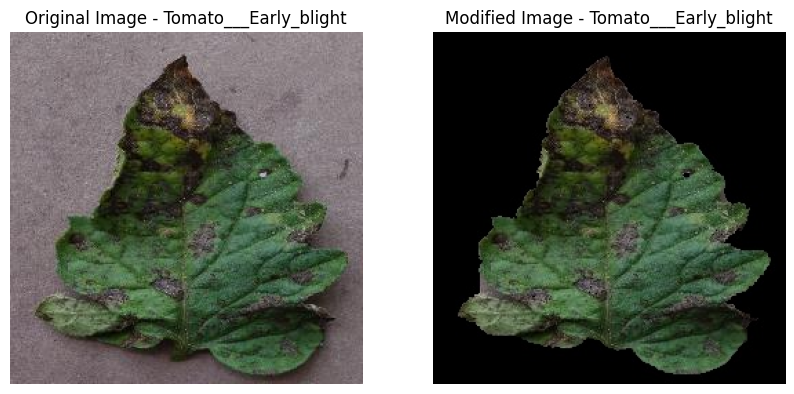

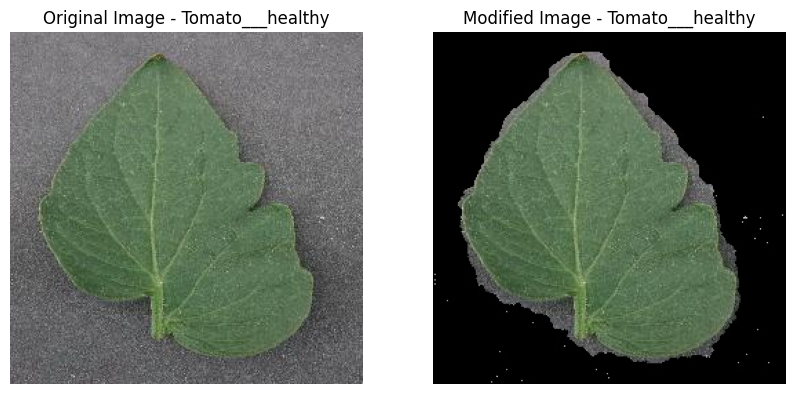

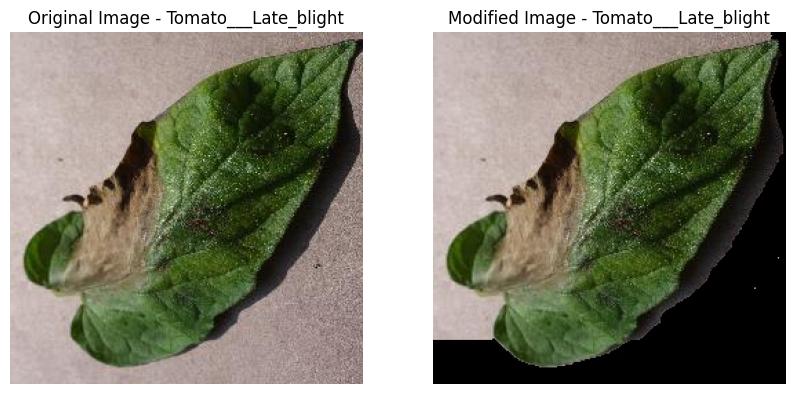

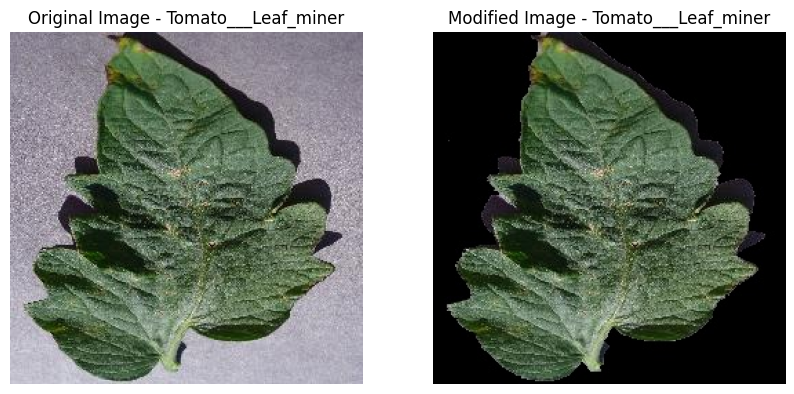

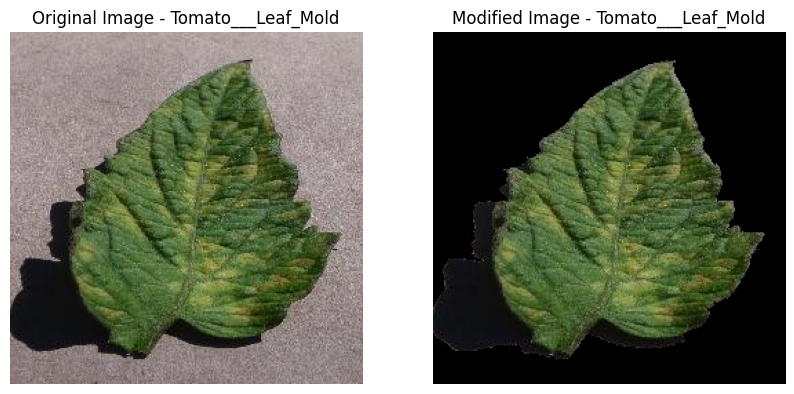

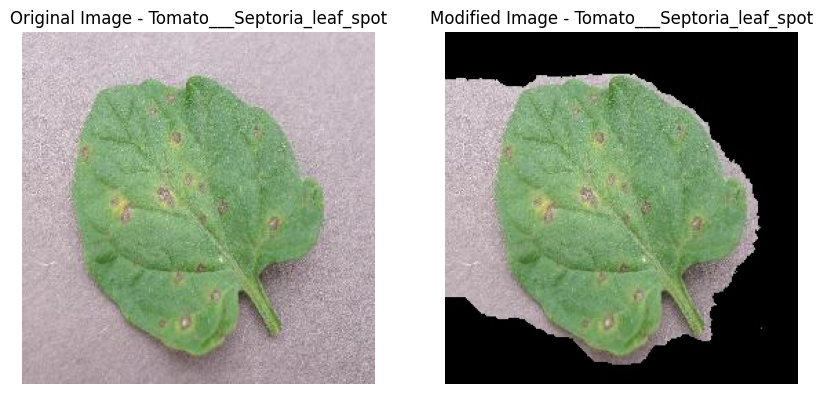

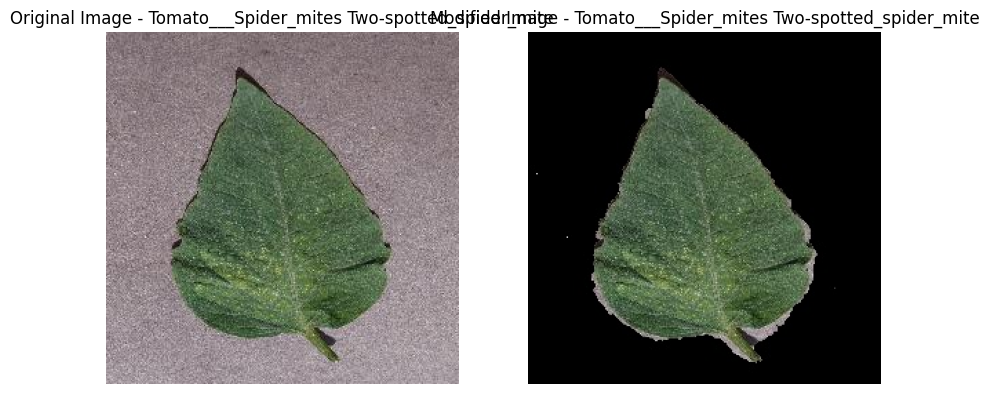

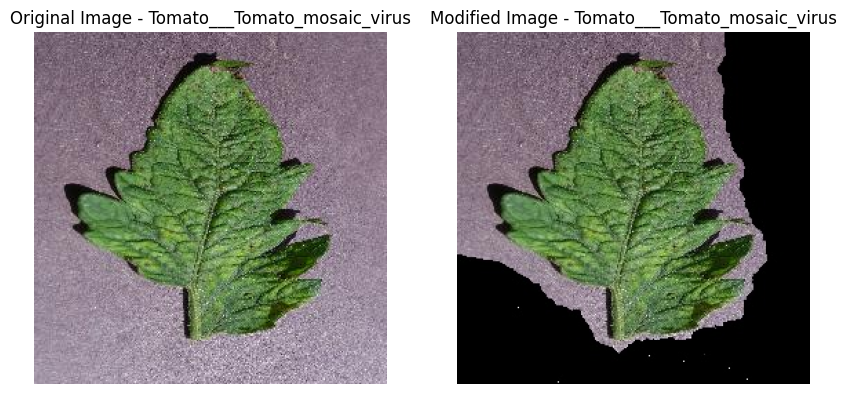

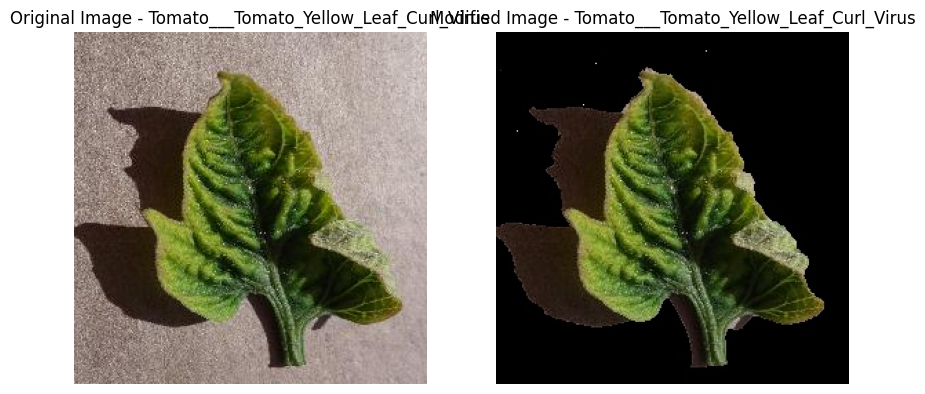

In [21]:
import os
import cv2
import matplotlib.pyplot as plt

# Function to display image comparison
def display_image_comparison(original_image, modified_image, class_name):
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
    axes[0].set_title('Original Image - ' + class_name)
    axes[0].axis('off')
    axes[1].imshow(cv2.cvtColor(modified_image, cv2.COLOR_BGR2RGB))
    axes[1].set_title('Modified Image - ' + class_name)
    axes[1].axis('off')
    plt.show()

# Main function
def main():
    # Set directories
    original_images_dir = "C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/Tomata Leaf Disease Dataset 0/tomato/train"
    modified_images_dir = "C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/Tomata Leaf Disease Dataset 0/tomato/background_removed_grabcut/train"

    # Get list of classes
    classes = os.listdir(modified_images_dir)

    # Process images for each class
    for class_name in classes:
        # Get paths for one image from each class
        original_image_path = os.path.join(original_images_dir, class_name, os.listdir(os.path.join(original_images_dir, class_name))[114])
        modified_image_path = os.path.join(modified_images_dir, class_name, os.listdir(os.path.join(modified_images_dir, class_name))[114])

        # Read images
        original_image = cv2.imread(original_image_path)
        modified_image = cv2.imread(modified_image_path)

        # Display image comparison
        display_image_comparison(original_image, modified_image, class_name)

if __name__ == "__main__":
    main()

## Implementing YOLOv5

In [1]:
#!git clone https://github.com/ultralytics/yolov5  # clone
%cd C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov5
!pip install -r requirements.txt  

C:\Users\ambar\OneDrive - vit.ac.in\Capstone Project\yolov5


c:\Users\ambar\AppData\Local\Programs\Python\Python311\Lib\site-packages\IPython\core\magics\osm.py:417: UserWarning: using dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


In [1]:
!git clone https://github.com/ultralytics/yolov5  # clone
%cd yolov5
%pip install -qr requirements.txt comet_ml  # install

import torch
import utils
display = utils.notebook_init()  # checks

## Training YOLOv5 model

In [2]:
import PIL
from PIL import Image

In [ ]:
# Train YOLOv5s
!python train.py --img 640 --batch 16 --epochs 10 --data /content/yolov5/Tomata-Leaf-Disease-3/data.yaml --weights yolov5s.pt --cache

2024-03-02 12:53:18.685831: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-03-02 12:53:18.685892: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-03-02 12:53:18.687354: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=yolov5s.pt, cfg=, data=/content/yolov5/Tomata-Leaf-Disease-3/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=10, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, evolve_population=data/hyps, resume_evolve=None, bucket=, cache=ram, image_weights=False, device=, multi

In [2]:
# Train YOLOv5s 
!python train.py --img 224 --batch 32 --epochs 10 --data /content/yolov5/Tomato-Leaf-Disease-6/data.yaml --weights yolov5s.pt --cache

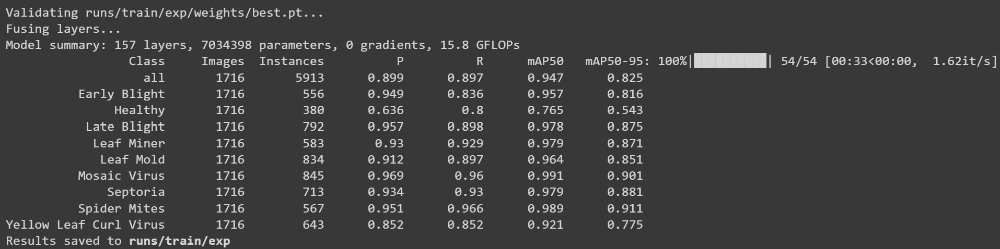

In [10]:
PIL.Image.open("C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/screenshots/yolov5a3.jpg")

## Visualizing Results

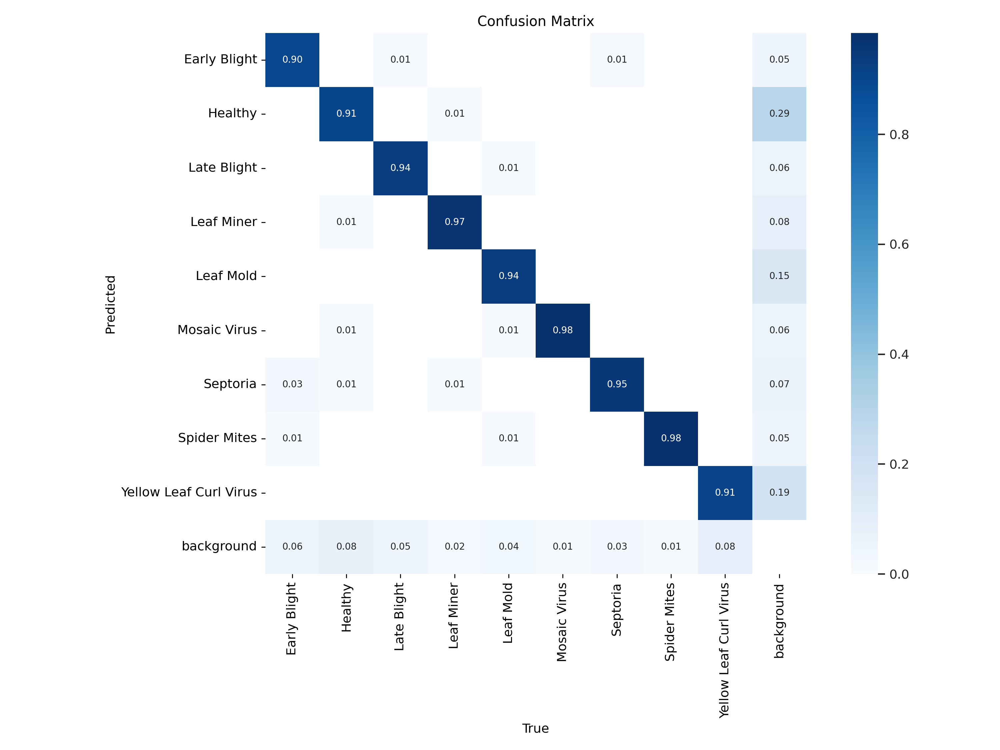

In [3]:
PIL.Image.open("C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov5/runs/runs2/train/exp/confusion_matrix.png")

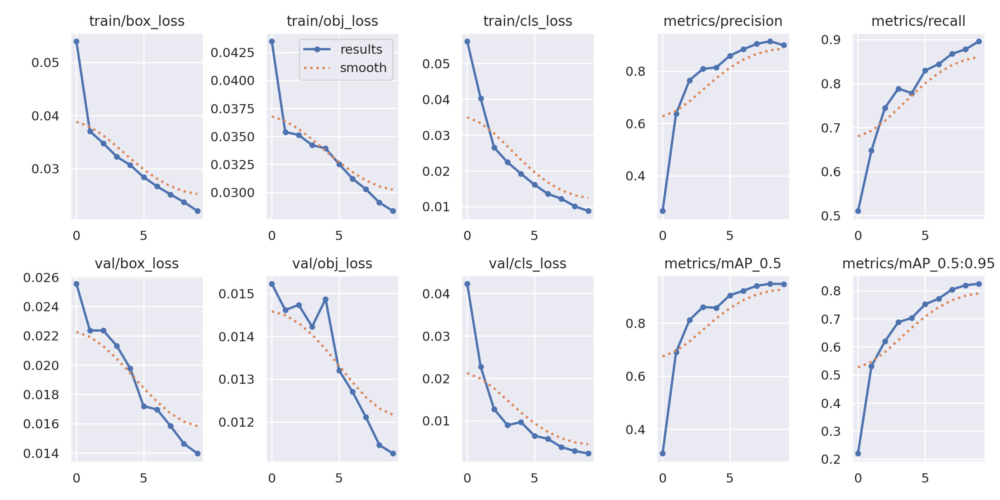

In [6]:
PIL.Image.open("C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov5/runs/runs2/train/exp/results.png")

## Testing Model

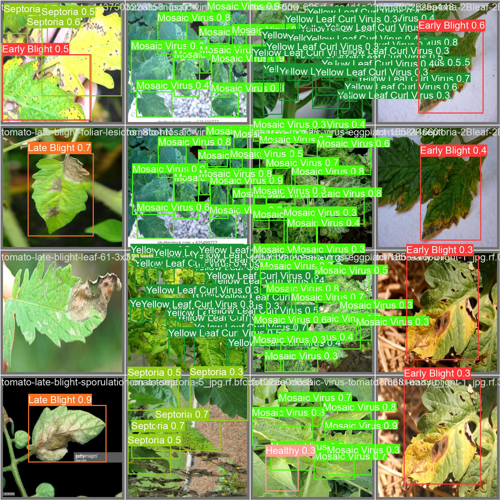

In [8]:
PIL.Image.open("C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov5/runs/runs2/train/exp/val_batch0_pred.jpg").resize((500,500))

## Implementing YOLOv7

In [7]:
# Download YOLOv7 repository and install requirements
#!git clone https://github.com/WongKinYiu/yolov7
%cd C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov7
!pip install -r requirements.txt

C:\Users\ambar\OneDrive - vit.ac.in\Capstone Project\yolov7


In [2]:
%cd C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov7

C:\Users\ambar\OneDrive - vit.ac.in\Capstone Project\yolov7


## Training YOLOv7 Model

In [6]:
!python train.py --workers 8 --batch-size 4 --epochs 2 --img 640 640 --data data/data.yaml --hyp hyp.scratch.tiny.yaml --cfg cfg/training/yolov7-tiny.yaml --name yolov7OUT --weights yolov7-tiny.pt

^C


In [1]:
import PIL
from PIL import Image

In [3]:
!python train.py --workers 8 --batch-size 64 --epochs 10 --img 224 224 --data data/data.yaml --hyp hyp.scratch.tiny.yaml --cfg cfg/training/yolov7-tiny.yaml --name yolov7OUT6f --weights yolov7-tiny.pt

^C


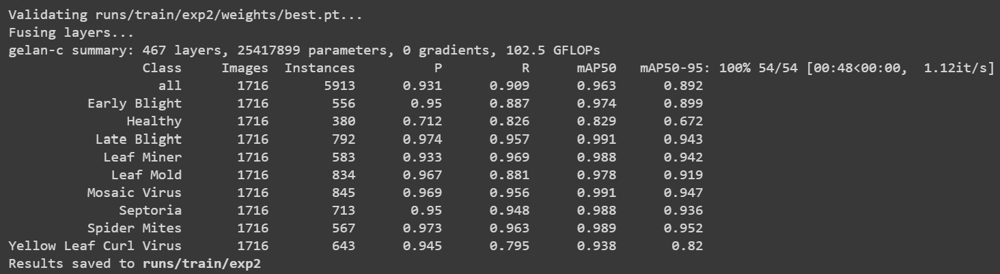

In [8]:
PIL.Image.open("C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov7/runs/runs2/train/exp3/yolov7b3.jpg")

## Visualizing Results

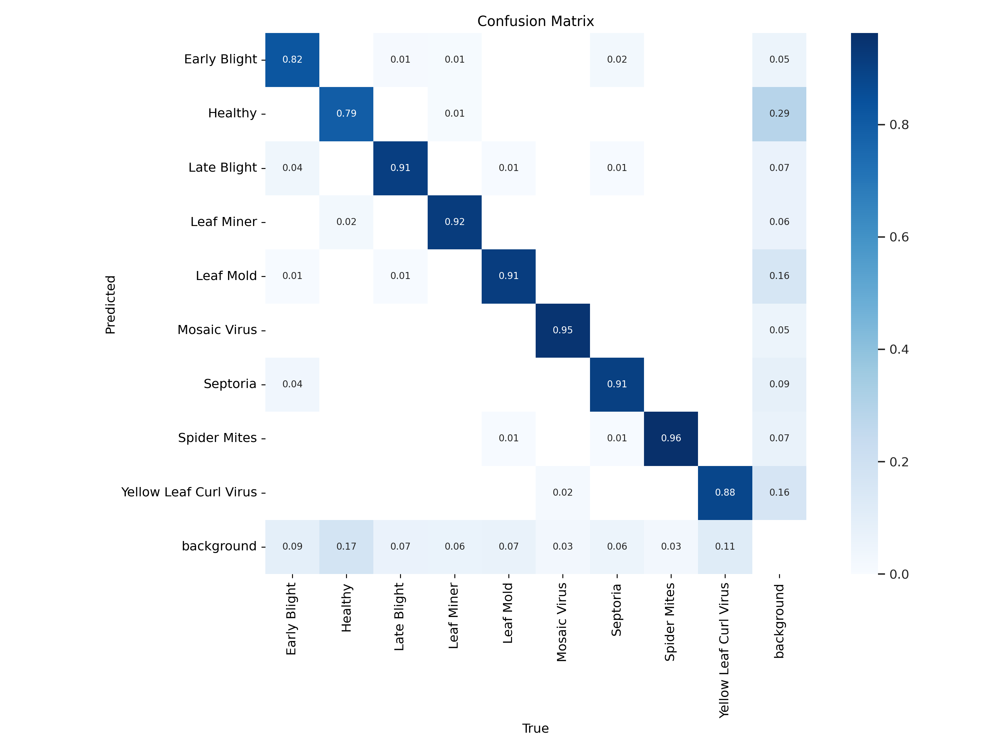

In [3]:
PIL.Image.open("C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov7/runs/runs2/train/exp3/confusion_matrix.png")

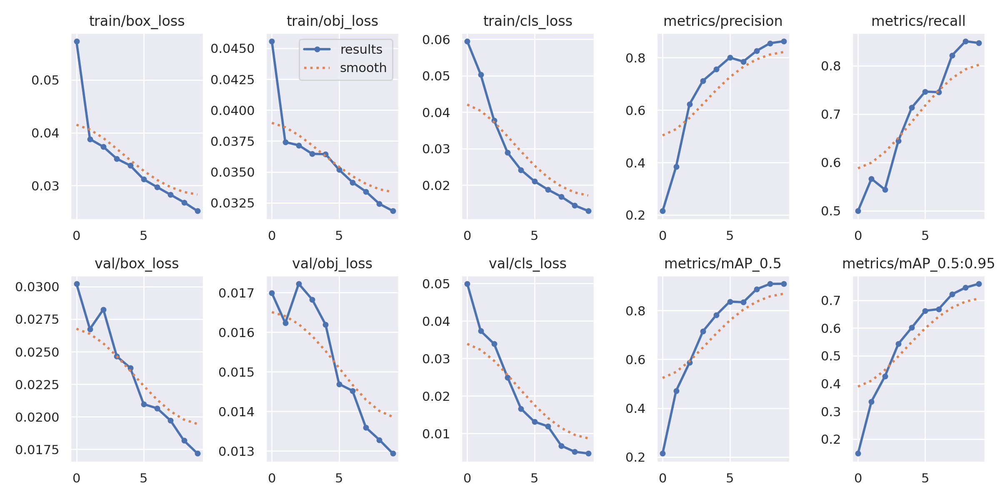

In [6]:
PIL.Image.open("C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov7/runs/runs2/train/exp3/results.png")

## Testing Model

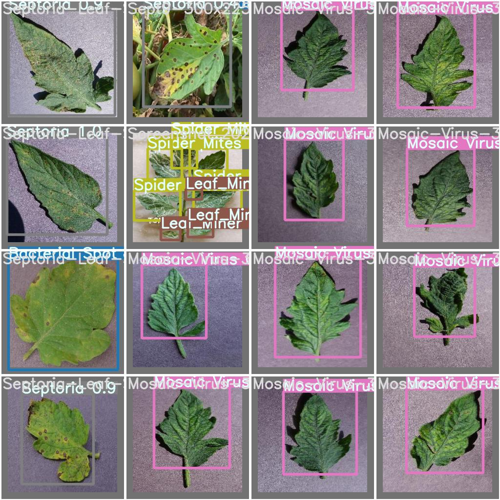

In [14]:
PIL.Image.open("C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov7/runs/train/yolov7OUT6f/test_batch2_pred.jpg").resize((500,500))

## Prediction

In [18]:
%cd C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov7

C:\Users\ambar\OneDrive - vit.ac.in\Capstone Project\yolov7


In [22]:
!python detect.py --weights finalYOLOv7weights.pt --conf 0.5 --img-size 224 --source testingimages/testimg4.jpg 
# --view-img --no-trace

Namespace(weights=['finalYOLOv7weights.pt'], source='testingimages/testimg4.jpg', img_size=224, conf_thres=0.5, iou_thres=0.45, device='', view_img=False, save_txt=False, save_conf=False, nosave=False, classes=None, agnostic_nms=False, augment=False, update=False, project='runs/detect', name='exp', exist_ok=False, no_trace=False)
Fusing layers... 
IDetect.fuse
 Convert model to Traced-model... 
 traced_script_module saved! 
 model is traced! 

2 Healthys, 2 Leaf_Miners, Done. (219.3ms) Inference, (0.0ms) NMS
 The image with the result is saved in: runs\detect\exp4\testimg4.jpg
Done. (0.235s)


YOLOR  2023-11-3 torch 2.2.0+cpu CPU

C:\Users\ambar\AppData\Local\Programs\Python\Python311\Lib\site-packages\torch\functional.py:507: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ..\aten\src\ATen\native\TensorShape.cpp:3550.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
Model Summary: 208 layers, 6031950 parameters, 0 gradients, 13.1 GFLOPS


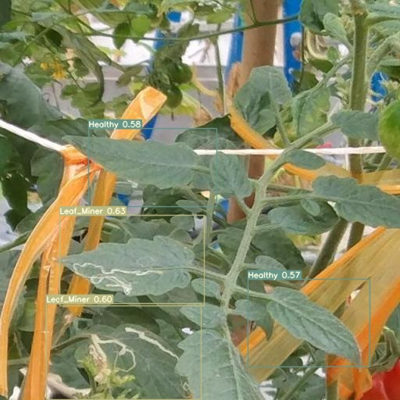

In [24]:
PIL.Image.open("C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov7/runs/detect/exp4/testimg4.jpg").resize((400,400))

## Implementing YOLOv8

In [23]:
%cd C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov8

C:\Users\ambar\OneDrive - vit.ac.in\Capstone Project\yolov8


In [1]:
!pip install ultralytics

In [24]:
from ultralytics import YOLO

## Training Model

In [ ]:
from ultralytics import YOLO

# Load a model
model = YOLO("yolov8n.yaml")  # build a new model from scratch
model = YOLO("yolov8n.pt")  # load a pretrained model (recommended for training)

# Use the model
model.train(data="C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov7/data/data.yaml", epochs=1)  # train the model

# OR
!yolo task=detect mode=train epochs=1 data=data.yaml model=yolov8n.pt imgsz=224 batch=32

In [4]:
!yolo task=detect mode=train epochs=1 data=data.yaml model=yolov8n.pt imgsz=224 batch=32 name=yolov8OUT1

^C


In [ ]:
# Train YOLOv8n
!yolo train model=yolov8n.pt data=/content/Tomata-Leaf-Disease-3/data.yaml epochs=10 imgsz=640

Ultralytics YOLOv8.1.20 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/Tomata-Leaf-Disease-3/data.yaml, epochs=10, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_c

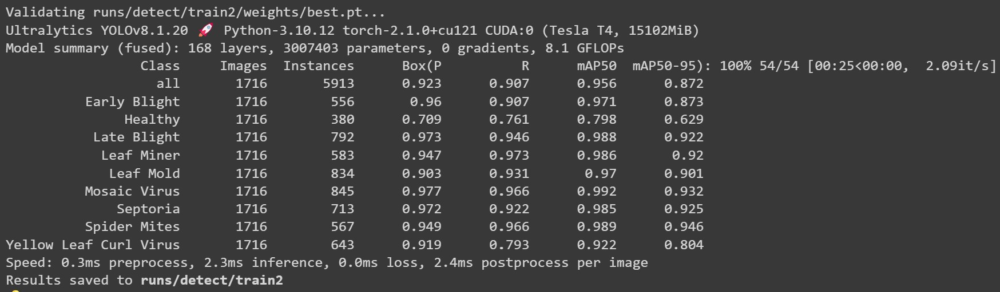

In [28]:
PIL.Image.open("C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/screenshots/yolov8a3.jpg")

## Visualizing Results

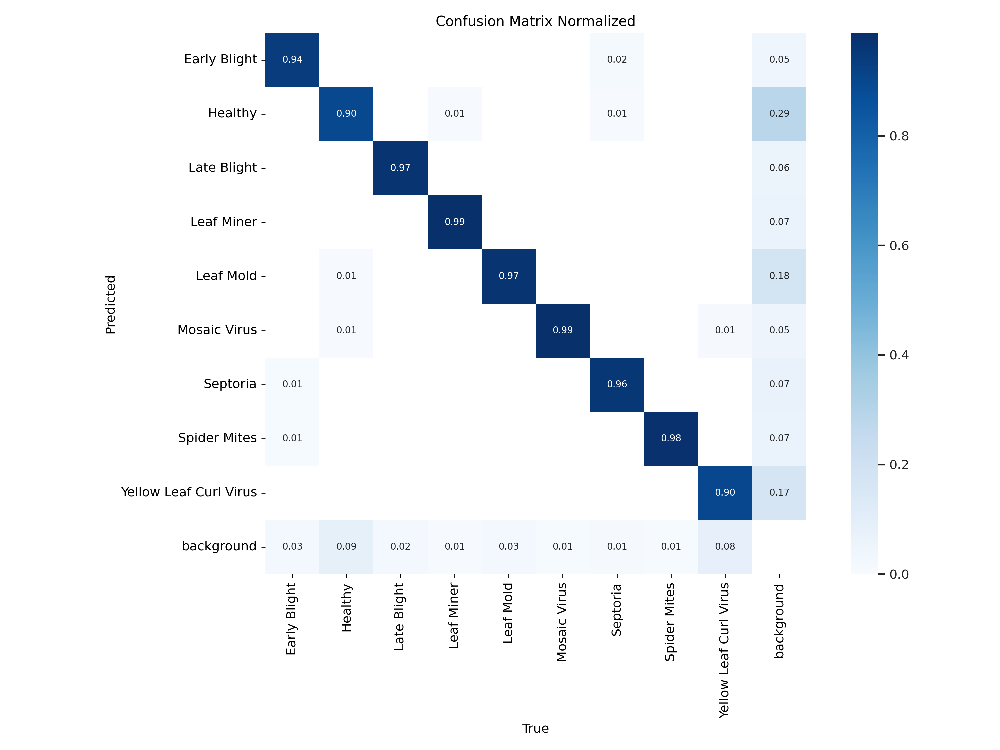

In [29]:
PIL.Image.open("C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov8/runs/runs3/detect/train2/confusion_matrix_normalized.png")

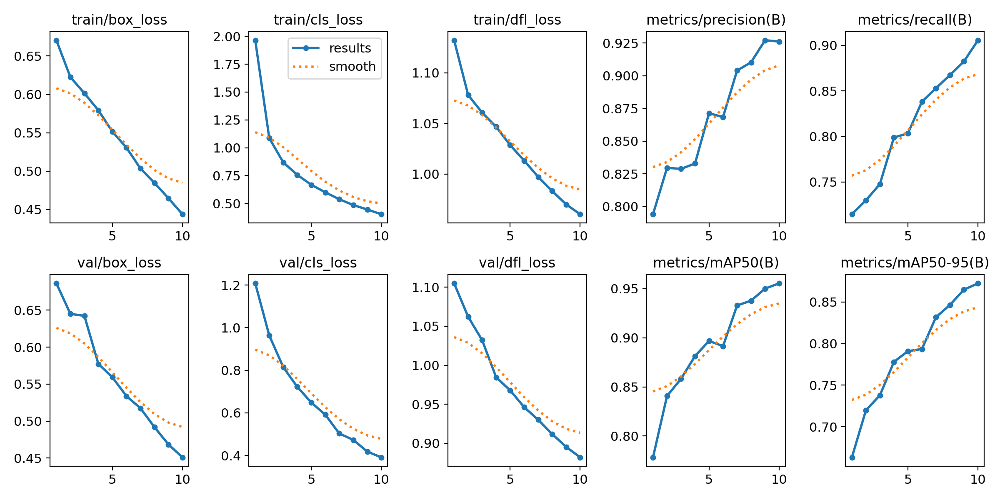

In [32]:
PIL.Image.open("C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov8/runs/runs3/detect/train2/results.png")

## Testing Model

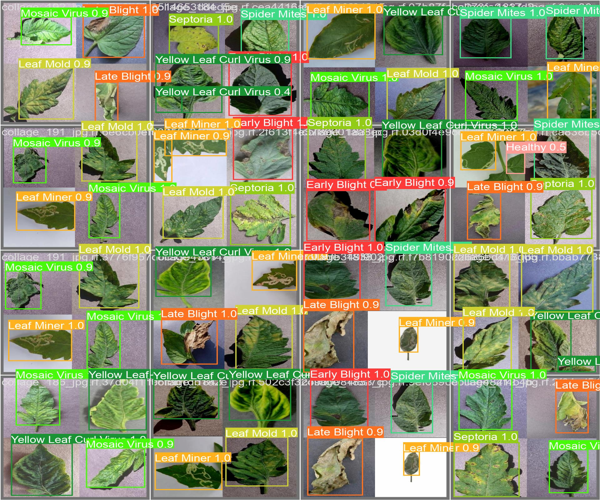

In [43]:
PIL.Image.open("C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov8/runs/runs3/detect/train2/val_batch2_pred.jpg").resize((600,500))

## Prediction

In [36]:
%cd C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov8
from ultralytics import YOLO

C:\Users\ambar\OneDrive - vit.ac.in\Capstone Project\yolov8


In [37]:
!yolo task=detect mode=predict model=finalYOLOv8weights3.pt source=testingimages/testimg10.jpg

Ultralytics YOLOv8.1.10 ðŸš€ Python-3.11.6 torch-2.2.0+cpu CPU (13th Gen Intel Core(TM) i5-13500H)
Model summary (fused): 168 layers, 3007403 parameters, 0 gradients, 8.1 GFLOPs

image 1/1 C:\Users\ambar\OneDrive - vit.ac.in\Capstone Project\yolov8\testingimages\testimg10.jpg: 512x640 3 Late Blights, 176.3ms
Speed: 3.6ms preprocess, 176.3ms inference, 0.0ms postprocess per image at shape (1, 3, 512, 640)
Results saved to runs\detect\predict22
ðŸ’¡ Learn more at https://docs.ultralytics.com/modes/predict


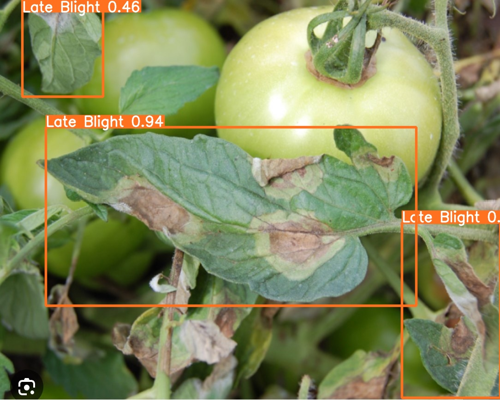

In [42]:
PIL.Image.open("C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov8/runs/detect/predict22/testimg10.jpg").resize((500,400))

In [45]:
!yolo task=detect mode=predict model=finalYOLOv8weights3.pt source=testingimages/testimg11.jpg

Ultralytics YOLOv8.1.10 ðŸš€ Python-3.11.6 torch-2.2.0+cpu CPU (13th Gen Intel Core(TM) i5-13500H)
Model summary (fused): 168 layers, 3007403 parameters, 0 gradients, 8.1 GFLOPs

image 1/1 C:\Users\ambar\OneDrive - vit.ac.in\Capstone Project\yolov8\testingimages\testimg11.jpg: 480x640 1 Leaf Mold, 1 Mosaic Virus, 170.6ms
Speed: 0.0ms preprocess, 170.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
Results saved to runs\detect\predict23
ðŸ’¡ Learn more at https://docs.ultralytics.com/modes/predict


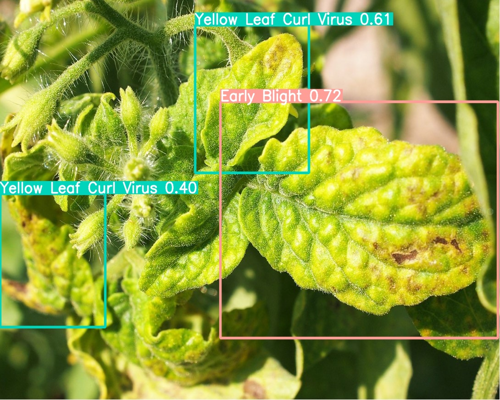

In [47]:
PIL.Image.open("C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov8/runs/detect/predict17/testimg11.jpg").resize((500,400))

In [54]:
!yolo task=detect mode=predict model=finalYOLOv8weights3.pt source=testingimages/testimg4.jpg

Ultralytics YOLOv8.1.10 ðŸš€ Python-3.11.6 torch-2.2.0+cpu CPU (13th Gen Intel Core(TM) i5-13500H)
Model summary (fused): 168 layers, 3007403 parameters, 0 gradients, 8.1 GFLOPs

image 1/1 C:\Users\ambar\OneDrive - vit.ac.in\Capstone Project\yolov8\testingimages\testimg4.jpg: 640x640 5 Healthys, 2 Leaf Miners, 183.8ms
Speed: 4.0ms preprocess, 183.8ms inference, 10.1ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs\detect\predict26
ðŸ’¡ Learn more at https://docs.ultralytics.com/modes/predict


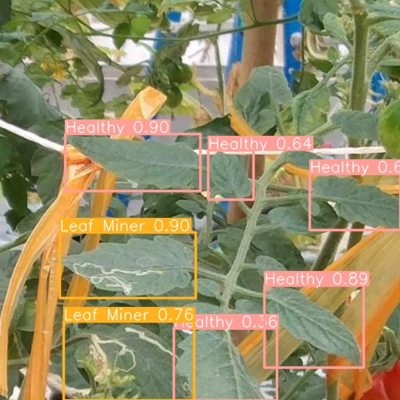

In [55]:
PIL.Image.open("C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov8/runs/detect/predict26/testimg4.jpg").resize((400,400))

## Implementing YOLOv9

In [65]:
# !git clone https://github.com/SkalskiP/yolov9.git
%cd C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov9
!pip install -r requirements.txt -q

C:\Users\ambar\OneDrive - vit.ac.in\Capstone Project\yolov9


## Training YOLOv9

In [66]:
# Training 
!python train.py \
--batch 16 --epochs 10 --img 640 --device 0 --min-items 0 --close-mosaic 15 \
--data {dataset.location}/data.yaml \
--weights {HOME}/weights/gelan-c.pt \
--cfg models/detect/gelan-c.yaml \
--hyp hyp.scratch-high.yaml

In [ ]:
%cd {HOME}/yolov9

!python train.py \
--batch 16 --epochs 10 --img 640 --device 0 --min-items 0 --close-mosaic 15 \
--data {dataset.location}/data.yaml \
--weights {HOME}/weights/gelan-c.pt \
--cfg models/detect/gelan-c.yaml \
--hyp hyp.scratch-high.yaml

/content/yolov9
2024-03-02 04:19:34.203868: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-03-02 04:19:34.203923: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-03-02 04:19:34.205363: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-03-02 04:19:35.225727: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
train: weights=/content/weights/gelan-c.pt, cfg=models/detect/gelan-c.yaml, data=/content/yolov9/Tomata-Leaf-Disease-3/data.yaml, hyp=hyp.scratch-high.yaml, epochs=10, batch_size=16, imgsz=640, rect=False, resume=False, nosav

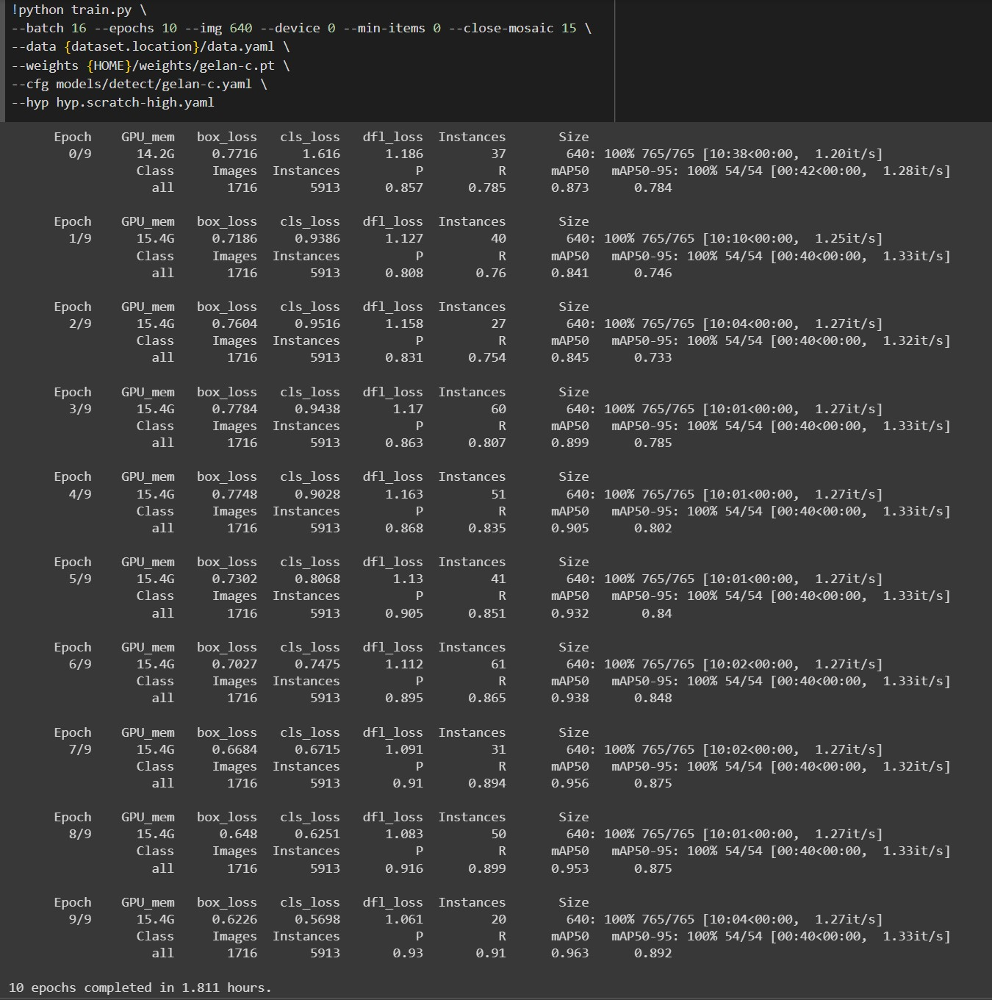

In [68]:
# Epochs
PIL.Image.open("C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/screenshots/yolov9c2.jpg")

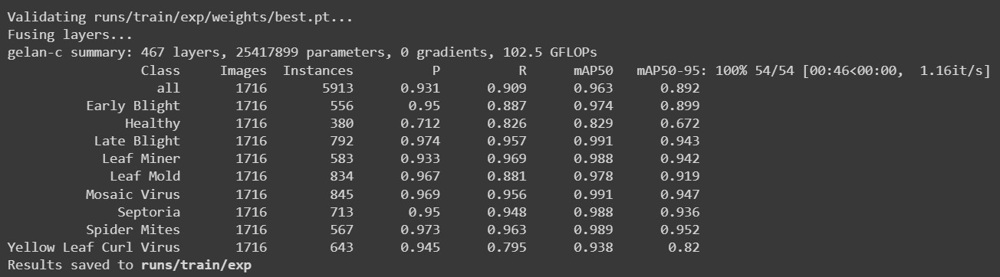

In [69]:
# Result
PIL.Image.open("C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/screenshots/yolov9c3.jpg")

## Visualizing Results

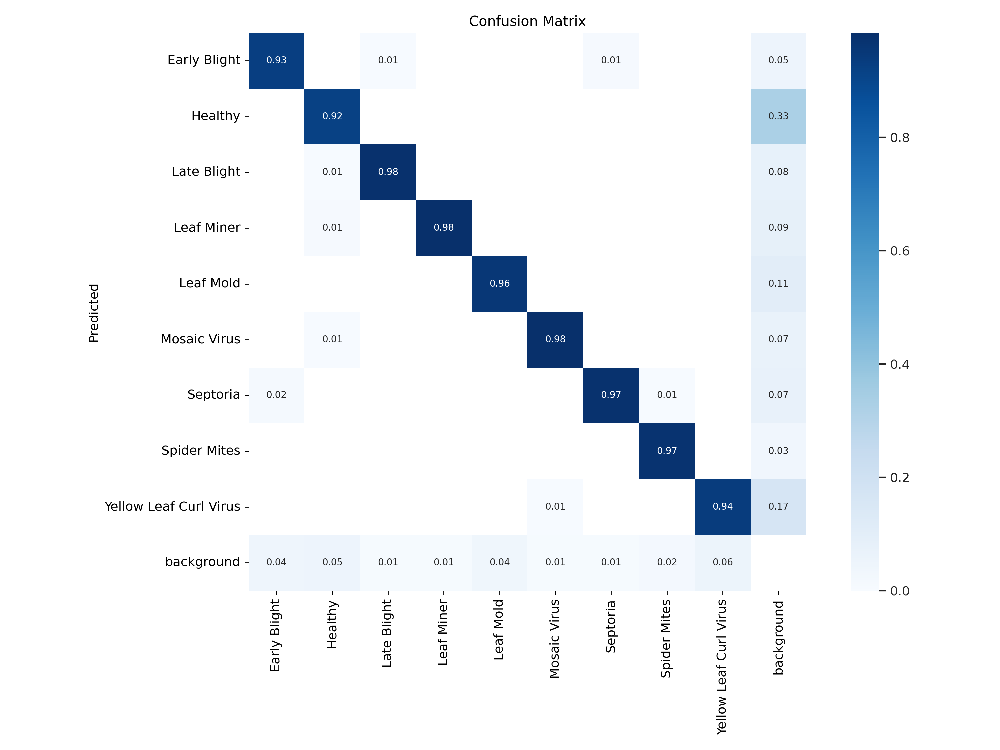

In [70]:
# Confusion Matrix
PIL.Image.open("C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov9/runs/train/exp/confusion_matrix.png")

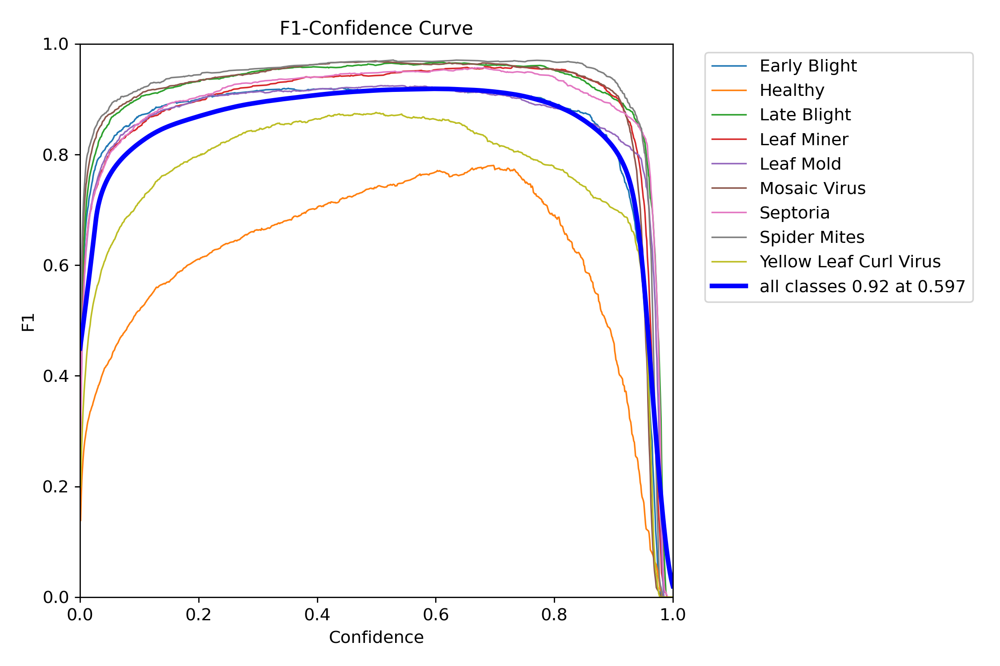

In [75]:
# F1-score
PIL.Image.open("C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov9/runs/train/exp/F1_curve.png")

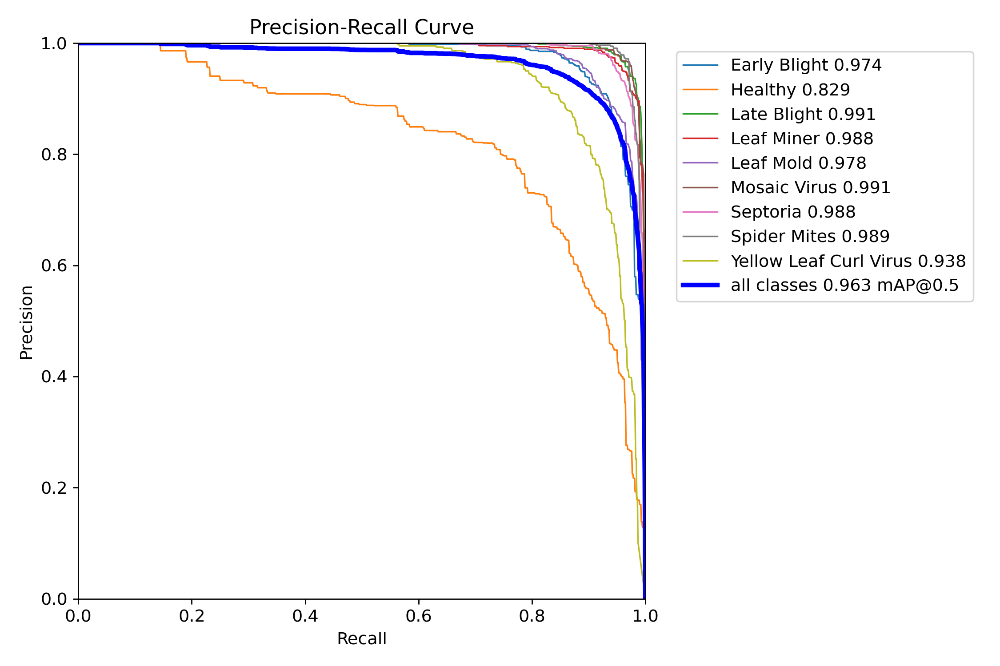

In [76]:
# PR curve
PIL.Image.open("C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov9/runs/train/exp/PR_curve.png")

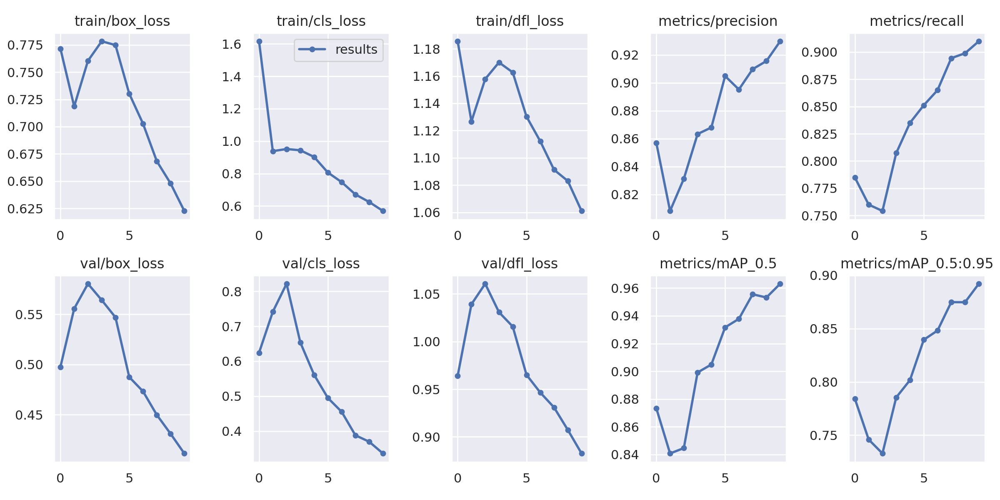

In [77]:
# Results
PIL.Image.open("C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov9/runs/train/exp/results.png")

## Testing

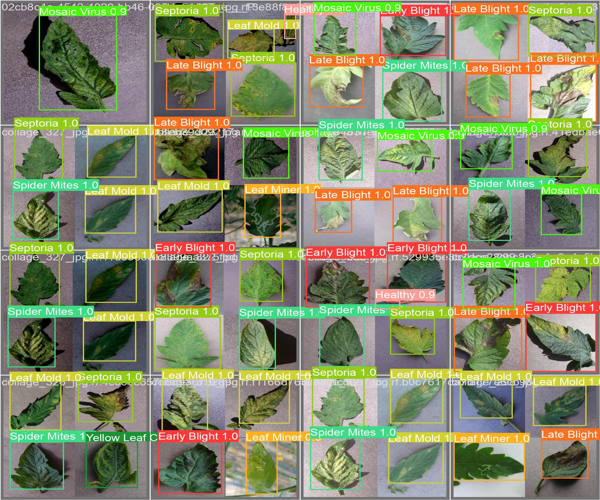

In [80]:
PIL.Image.open("C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov9/runs/train/exp/val_batch0_pred.jpg").resize((600,500))

## Prediction

In [2]:
%cd C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov9

C:\Users\ambar\OneDrive - vit.ac.in\Capstone Project\yolov9


In [83]:
!python detect.py --weights finalYOLOv9weights.pt --conf 0.1 --source "C:\Users\ambar\OneDrive - vit.ac.in\Capstone Project\yolov8\testingimages\testimg10.jpg"

detect: weights=['finalYOLOv9weights.pt'], source=C:\Users\ambar\OneDrive - vit.ac.in\Capstone Project\yolov8\testingimages\testimg10.jpg, data=data\coco128.yaml, imgsz=[640, 640], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs\detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5  2024-3-2 Python-3.11.6 torch-2.2.0+cpu CPU

Fusing layers... 
gelan-c summary: 387 layers, 25234027 parameters, 0 gradients, 101.8 GFLOPs
image 1/1 C:\Users\ambar\OneDrive - vit.ac.in\Capstone Project\yolov8\testingimages\testimg10.jpg: 512x640 5 Late Blights, 1273.8ms
Speed: 0.0ms pre-process, 1273.8ms inference, 0.0ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs\detect\exp


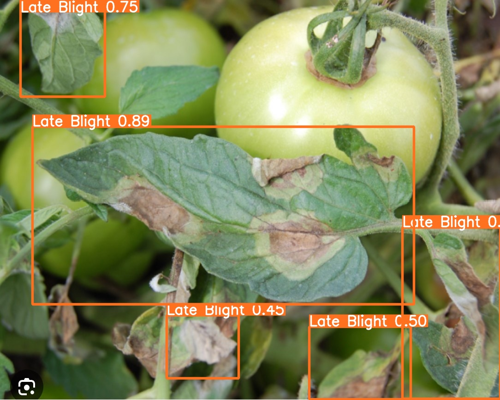

In [84]:
PIL.Image.open("C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov9/runs/detect/exp/testimg10.jpg").resize((500,400))

In [91]:
!python detect.py --weights finalYOLOv9weights.pt --conf 0.1 --source "C:\Users\ambar\OneDrive - vit.ac.in\Capstone Project\yolov8\testingimages\testimg4.jpg"

detect: weights=['finalYOLOv9weights.pt'], source=C:\Users\ambar\OneDrive - vit.ac.in\Capstone Project\yolov8\testingimages\testimg4.jpg, data=data\coco128.yaml, imgsz=[640, 640], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs\detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5  2024-3-2 Python-3.11.6 torch-2.2.0+cpu CPU

Fusing layers... 
gelan-c summary: 387 layers, 25234027 parameters, 0 gradients, 101.8 GFLOPs
image 1/1 C:\Users\ambar\OneDrive - vit.ac.in\Capstone Project\yolov8\testingimages\testimg4.jpg: 640x640 6 Healthys, 2 Leaf Miners, 693.0ms
Speed: 0.0ms pre-process, 693.0ms inference, 0.0ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs\detect\exp4


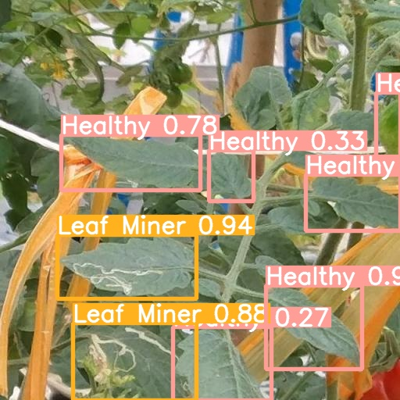

In [93]:
PIL.Image.open("C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov9/runs/detect/exp4/testimg4.jpg").resize((400,400))

In [3]:
!python detect.py --weights finalYOLOv9weights.pt --conf 0.1 --source "C:/Users/ambar/OneDrive/Pictures/Screenshots/img1.jpg"

detect: weights=['finalYOLOv9weights.pt'], source=C:/Users/ambar/OneDrive/Pictures/Screenshots/img1.jpg, data=data\coco128.yaml, imgsz=[640, 640], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs\detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5  2024-3-2 Python-3.11.6 torch-2.2.0+cpu CPU

Fusing layers... 
gelan-c summary: 387 layers, 25234027 parameters, 0 gradients, 101.8 GFLOPs
image 1/1 C:\Users\ambar\OneDrive\Pictures\Screenshots\img1.jpg: 640x640 1 Early Blight, 1590.1ms
Speed: 6.3ms pre-process, 1590.1ms inference, 10.5ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs\detect\exp7


In [4]:
import PIL
from PIL import Image

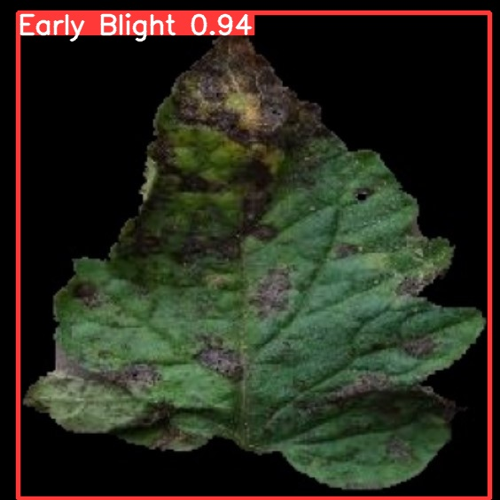

In [6]:
PIL.Image.open("C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov9/runs/detect/exp7/img1.jpg").resize((500,500))

## XAI - LRP Heatmap

In [15]:
from ultralytics import YOLO
from easy_explain import YOLOv8LRP
from PIL import Image
import numpy as np
import torch
import matplotlib.pyplot as plt
import torchvision

In [54]:
image = Image.open("C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov8/testingimages/testimg14.jpg")

desired_size = (640, 640)
transform = torchvision.transforms.Compose([
    torchvision.transforms.Resize(desired_size),
    torchvision.transforms.ToTensor(),
])

image = transform(image).to('cpu').float()

In [55]:
yolo = YOLO('finalYOLOv8weights.pt')
detection = yolo(image)


WARNING ⚠️ torch.Tensor inputs should be BCHW i.e. shape(1, 3, 640, 640) divisible by stride 32. Input shape(3, 640, 640) is incompatible.
0: 640x640 10 Early Blights, 1 Late Blight, 267.9ms
Speed: 0.0ms preprocess, 267.9ms inference, 15.6ms postprocess per image at shape (1, 3, 640, 640)


In [56]:
# Instantiate a w2-rule relevance propagation object
lrp = YOLOv8LRP(yolo, power=2, eps=1e-05, device='cpu')

In [57]:
explanation_lrp_leaf = lrp.explain(image, cls='Early Blight', contrastive=False).cpu()

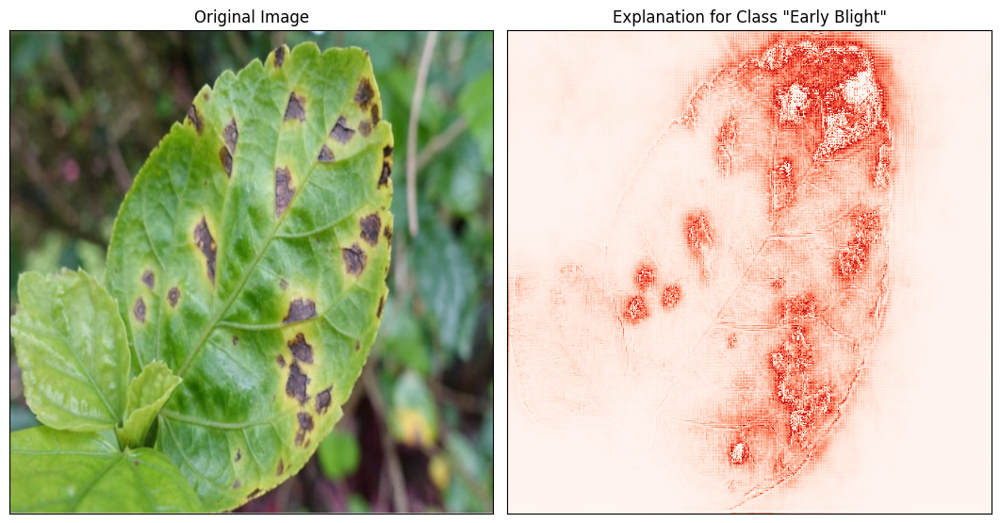

In [58]:
# Plotting the original image
plt.figure(figsize=(16,16))
plt.subplot(1, 3, 1)
plt.imshow(torch.cat([image[c, :, :].cpu().unsqueeze(-1) for c in range(3)], axis=-1))
plt.title('Original Image')
plt.xticks([]); plt.yticks([])

# Plotting the explanation for class 'person crp'
plt.subplot(1, 3, 2)
plt.imshow(explanation_lrp_leaf, cmap='Reds')
maxrel = np.abs(explanation_lrp_leaf).max()
plt.clim(vmin=0, vmax=maxrel)
plt.title('Explanation for Class "Early Blight"')
plt.xticks([]); plt.yticks([])

plt.tight_layout()
plt.show()

In [64]:
image = Image.open("C:/Users/ambar/OneDrive/Pictures/Screenshots/img1.jpg")

desired_size = (640, 640)
transform = torchvision.transforms.Compose([
    torchvision.transforms.Resize(desired_size),
    torchvision.transforms.ToTensor(),
])

image = transform(image).to('cpu').float()

In [65]:
%cd C:/Users/ambar/OneDrive - vit.ac.in/Capstone Project/yolov8

C:\Users\ambar\OneDrive - vit.ac.in\Capstone Project\yolov8


In [66]:
yolo = YOLO('finalYOLOv8weights.pt')
detection = yolo(image)


WARNING ⚠️ torch.Tensor inputs should be BCHW i.e. shape(1, 3, 640, 640) divisible by stride 32. Input shape(3, 640, 640) is incompatible.
0: 640x640 5 Late Blights, 316.9ms
Speed: 0.0ms preprocess, 316.9ms inference, 14.2ms postprocess per image at shape (1, 3, 640, 640)


In [67]:
# Instantiate a w2-rule relevance propagation object
lrp = YOLOv8LRP(yolo, power=2, eps=1e-05, device='cpu')

In [68]:
explanation_lrp_leaf = lrp.explain(image, cls='Early Blight', contrastive=False).cpu()

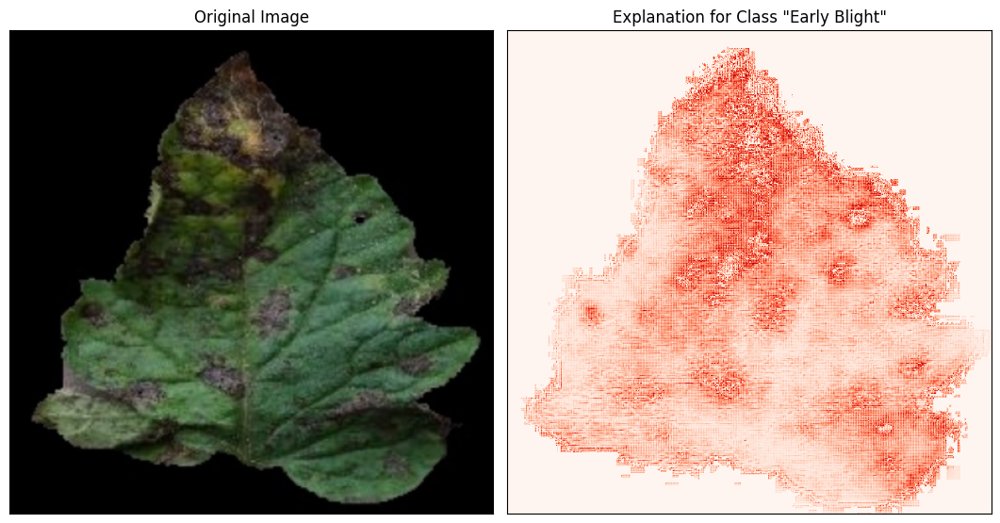

In [69]:
# Plotting the original image
plt.figure(figsize=(16,16))
plt.subplot(1, 3, 1)
plt.imshow(torch.cat([image[c, :, :].cpu().unsqueeze(-1) for c in range(3)], axis=-1))
plt.title('Original Image')
plt.xticks([]); plt.yticks([])

# Plotting the explanation for class 'person crp'
plt.subplot(1, 3, 2)
plt.imshow(explanation_lrp_leaf, cmap='Reds')
maxrel = np.abs(explanation_lrp_leaf).max()
plt.clim(vmin=0, vmax=maxrel)
plt.title('Explanation for Class "Early Blight"')
plt.xticks([]); plt.yticks([])

plt.tight_layout()
plt.show()
